## Libraries

In [1]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
import glob
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.utils.visualizer import ColorMode
import torch
from torch import cuda

In [2]:
# Select device which is not used

torch.cuda.empty_cache()
torch.cuda.set_device(2)
torch.cuda.current_device()
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
import shutil

shutil.copyfile('/data/home/quentinh/Lyoproject/Training Data for Particle Detection IFPAC (1).json','train.json')
shutil.copyfile('/data/home/quentinh/Lyoproject/Validation Data for Particle Detection IFPAC.json','validjson')
shutil.copyfile('/data/home/quentinh/Lyoproject/Test Data for Particle Detection IFPAC.json','test.json')

## Prepare dataset

In [3]:
#Register your data

register_coco_instances("my_dataset_train", {}, 
                        "/data/home/nusreti/sideProjects/Particle Detection/Final Data Publication/mergedAnnotations/train.json", 
                        "/data/home/nusreti/sideProjects/Particle Detection/Final Data Publication/mergedImages/train")
register_coco_instances("my_dataset_val", {}, 
                        "/data/home/nusreti/sideProjects/Particle Detection/Final Data Publication/mergedAnnotations/valid.json", 
                        "/data/home/nusreti/sideProjects/Particle Detection/Final Data Publication/mergedImages/validation")
register_coco_instances("my_dataset_test", {}, 
                        "/data/home/nusreti/sideProjects/Particle Detection/Final Data Publication/mergedAnnotations/testv3.json", 
                        "/data/home/nusreti/sideProjects/Particle Detection/Final Data Publication/mergedImages/test")

In [4]:
def cv2_imshow(im):
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    plt.figure(), plt.imshow(im), plt.axis('on')

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_test")
dataset_dicts = DatasetCatalog.get("my_dataset_test")

for d in random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])    

In [ ]:
vis = visualizer.draw_dataset_dict(d)
print(vis)

## Configuration

In [5]:
#Configurate model parameters

cfg = get_cfg()
cfg.MODEL.DEVICE = "cuda" if cuda.is_available() else "cpu"
cfg.merge_from_file(model_zoo.get_config_file("Misc/cascade_mask_rcnn_R_50_FPN_3x.yaml")) 

cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.OUTPUT_DIR = '/data/home/nusreti/sideProjects/Particle Detection/output/cascade_rcnn'

cfg.DATALOADER.NUM_WORKERS = 16
cfg.SOLVER.IMS_PER_BATCH = 16

cfg.SOLVER.BASE_LR = 0.001 
cfg.SOLVER.LR_SCHEDULER_NAME = 'WarmupCosineLR'
cfg.SOLVER.MAX_ITER = 6000 
cfg.SOLVER.STEPS = []

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128 
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg.TEST.EVAL_PERIOD = 500

cfg.MODEL.ROI_BOX_CASCADE_HEAD.IOUS = (0.35, 0.5, 0.65)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.IOU_THRESHOLDS = [0.35]

## Training step 

In [6]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.data import DatasetMapper, build_detection_train_loader
from detectron2.data import transforms as T

def build_sem_seg_train_aug(cfg):

    augs = [T.ResizeShortestEdge(
            cfg.INPUT.MIN_SIZE_TRAIN, cfg.INPUT.MAX_SIZE_TRAIN, cfg.INPUT.MIN_SIZE_TRAIN_SAMPLING),
            T.RandomBrightness(0.7, 1.5),
            T.RandomContrast(0.7, 1.5),
            T.RandomFlip(prob=0.25, horizontal=True, vertical=False),
            T.RandomFlip(prob=0.25, horizontal=False, vertical=True)]
    return augs

class CocoTrainer(DefaultTrainer):
    @classmethod
    def build_train_loader(cls, cfg):
        mapper = DatasetMapper(cfg, is_train=True, augmentations=build_sem_seg_train_aug(cfg))
        return build_detection_train_loader(cfg, mapper=mapper)
    
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):

        if output_folder is None:
            os.makedirs("/data/home/nusreti/sideProjects/Particle Detection/output/coco_eval", exist_ok=True)
            output_folder = "/data/home/nusreti/sideProjects/Particle Detection/output/coco_eval"

        return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/21 16:43:20 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.0.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (6, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.0.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (6,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.1.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (6, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.1.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (6,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.2.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (6, 1024) 

[12/21 16:43:22 d2.engine.train_loop]: Starting training from iteration 0


/opt/Anaconda3/envs/NI_DOE/lib/python3.8/site-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/opt/Anaconda3/envs/NI_DOE/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1639180588308/work/aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[12/21 16:43:47 d2.utils.events]:  eta: 1:50:25  iter: 19  total_loss: 9.093  loss_cls_stage0: 1.74  loss_box_reg_stage0: 0.714  loss_cls_stage1: 1.858  loss_box_reg_stage1: 0.8964  loss_cls_stage2: 1.802  loss_box_reg_stage2: 0.664  loss_mask: 0.693  loss_rpn_cls: 0.7225  loss_rpn_loc: 0.1118  time: 1.1138  data_time: 0.1489  lr: 1.8708e-05  max_mem: 15123M
[12/21 16:44:09 d2.utils.events]:  eta: 1:49:32  iter: 39  total_loss: 7.945  loss_cls_stage0: 1.444  loss_box_reg_stage0: 0.7525  loss_cls_stage1: 1.5  loss_box_reg_stage1: 0.9782  loss_cls_stage2: 1.454  loss_box_reg_stage2: 0.7789  loss_mask: 0.6892  loss_rpn_cls: 0.1759  loss_rpn_loc: 0.09939  time: 1.1058  data_time: 0.0600  lr: 3.7348e-05  max_mem: 15123M
[12/21 16:44:31 d2.utils.events]:  eta: 1:48:42  iter: 59  total_loss: 6.356  loss_cls_stage0: 0.9784  loss_box_reg_stage0: 0.7601  loss_cls_stage1: 0.9825  loss_box_reg_stage1: 0.9943  loss_cls_stage2: 0.9085  loss_box_reg_stage2: 0.8423  loss_mask: 0.6778  loss_rpn_cls: 0.

MetadataCatalog.get("mydataset").thing_classes## Inference 

In [7]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)

predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="/data/home/nusreti/sideProjects/Particle Detection/output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[01/21 16:08:13 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/opt/Anaconda3/envs/NI_DOE/lib/python3.8/site-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/opt/Anaconda3/envs/NI_DOE/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1639180588308/work/aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[01/21 16:08:21 d2.evaluation.evaluator]: Inference done 11/3000. Dataloading: 0.0030 s/iter. Inference: 0.0753 s/iter. Eval: 0.0371 s/iter. Total: 0.1154 s/iter. ETA=0:05:44
[01/21 16:08:26 d2.evaluation.evaluator]: Inference done 68/3000. Dataloading: 0.0038 s/iter. Inference: 0.0603 s/iter. Eval: 0.0273 s/iter. Total: 0.0916 s/iter. ETA=0:04:28
[01/21 16:08:31 d2.evaluation.evaluator]: Inference done 114/3000. Dataloading: 0.0036 s/iter. Inference: 0.0642 s/iter. Eval: 0.0322 s/iter. Total: 0.1002 s/iter. ETA=0:04:49
[01/21 16:08:36 d2.evaluation.evaluator]: Inference done 168/3000. Dataloading: 0.0034 s/iter. Inference: 0.0632 s/iter. Eval: 0.0312 s/iter. Total: 0.0980 s/iter. ETA=0:04:37
[01/21 16:08:41 d2.evaluation.evaluator]: Inference done 216/3000. Dataloading: 0.0034 s/iter. Inference: 0.0647 s/iter. Eval: 0.0314 s/iter. Total: 0.0997 s/iter. ETA=0:04:37
[01/21 16:08:47 d2.evaluation.evaluator]: Inference done 257/3000. Dataloading: 0.0033 s/iter. Inference: 0.0646 s/iter. E

OrderedDict([('bbox',
              {'AP': 42.398935764435194,
               'AP50': 67.7384061961488,
               'AP75': 47.17369878706636,
               'APs': 19.129304370867857,
               'APm': 48.12302072837297,
               'APl': 50.920340903215376,
               'AP-100µm': 37.93730415237506,
               'AP-fibers': 56.61378010898011,
               'AP-50cµm': 40.466099565158515,
               'AP-150µm': 57.33204320432043,
               'AP-Grey Particles from stopper': 19.645451791341888}),
             ('segm',
              {'AP': 44.3701413705329,
               'AP50': 67.86379711237818,
               'AP75': 52.45629790565339,
               'APs': 20.27198853402474,
               'APm': 50.67652671729935,
               'APl': 50.00459088236037,
               'AP-100µm': 40.7268919543905,
               'AP-fibers': 55.705529569781106,
               'AP-50cµm': 42.73955192507919,
               'AP-150µm': 61.93746678239253,
               'AP-

In [ ]:
# a delete apres 


/tmp/ipykernel_24301/1041143195.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(), plt.imshow(im), plt.axis('on')


Category: 100µm, Count: 49
Category: fibers, Count: 16
Category: 50µm, Count: 114


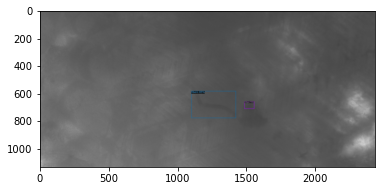

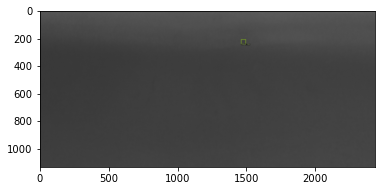

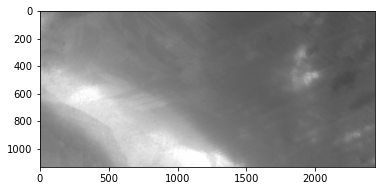

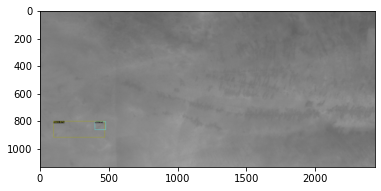

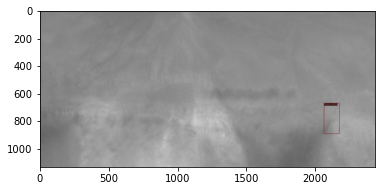

...

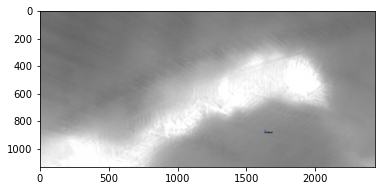

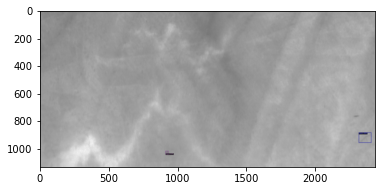

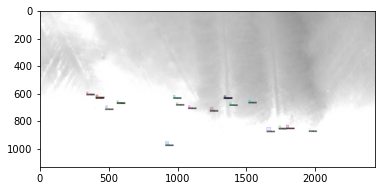

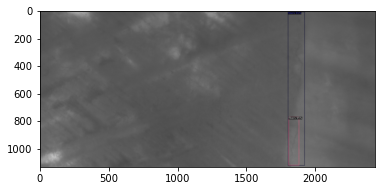

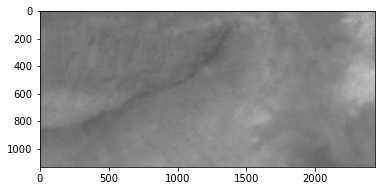

In [16]:
import os
import glob
import cv2

# Set the path to the input images directory
input_dir = 'Particle test folder/S50_7'

# Set the path to the output images directory
output_dir = 'Lyoproject/Test folder 3/S50_7'

# Set the model configuration
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.65 # set the testing threshold for this model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
predictor = DefaultPredictor(cfg)

import glob
import os
import cv2
from detectron2.utils.visualizer import Visualizer, ColorMode

# Initialize instance count dictionary
instance_count = {}

# Define category names
category_names = ["fibers", "100µm", "50µm", ...]  # Add all relevant category names

# Loop over the input images and process each one
for imageName in glob.glob(os.path.join(input_dir, '*png')):
    # Load the input image
    im = cv2.imread(imageName)
    # Run the model inference
    outputs = predictor(im)
    # Visualize the output predictions
    v = Visualizer(im[:, :, ::-1], metadata=my_dataset_train_metadata, instance_mode=ColorMode.SEGMENTATION)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Extract the file name (without extension) from the input image path
    filename = os.path.splitext(os.path.basename(imageName))[0]
    # Save the output image with a unique name based on the original file name
    cv2.imwrite(os.path.join(output_dir, f'{filename}_out.png'), out.get_image()[:, :, ::-1])
    # Display the output image
    cv2_imshow(out.get_image()[:, :, ::-1])

    # Count instances per category
    instances = outputs["instances"]
    for i in range(len(instances)):
        category_id = instances.pred_classes[i].item()
        category_name = category_names[category_id]
        if category_name in instance_count:
            instance_count[category_name] += 1
        else:
            instance_count[category_name] = 1

# Print instance counts per category
for category, count in instance_count.items():
    print(f"Category: {category}, Count: {count}")





In [ ]:
# a delete au dessus 

In [54]:
import csv
import cv2
import detectron2
from detectron2.engine import DefaultPredictor

# Set the threshold for the intersection over union (IOU) score
threshold = 0.75

# Load the configuration file for the model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.50  # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

# Create a list of dictionaries with the data
data = []
for test_image_dict in detectron2.data.get_detection_dataset_dicts(["my_dataset_test"]):
    detection_count = 0
    annotations = [[bbox['bbox'][0], bbox['bbox'][1], bbox['bbox'][0]+bbox['bbox'][2], bbox['bbox'][1]+bbox['bbox'][3]] for bbox in test_image_dict['annotations']]
    obj_count = len(annotations)
    im = cv2.imread(test_image_dict['file_name'])
    outputs = predictor(im)
    for pred_box in outputs['instances'].pred_boxes.tensor.cpu().numpy():
        for idx, annotation in enumerate(annotations):
            temp_iou = check_iou(pred_box, annotation)
            if temp_iou >= threshold:
                annotations.pop(idx)
                detection_count +=1
    percentage_correct = round(100*(detection_count/obj_count), 2)
    row = {
        'File Name': test_image_dict['file_name'],
        'Total annotated objects': obj_count,
        'Correct detections': detection_count,
        'Percentage of correct detections': percentage_correct
    }
    data.append(row)

# Write the data to a CSV file
with open('output_iou_0.75.csv', mode='w', newline='') as file:
    fieldnames = ['File Name', 'Total annotated objects', 'Correct detections', 'Percentage of correct detections']
    writer = csv.DictWriter(file, fieldnames=fieldnames)
    writer.writeheader()
    for row in data:
        writer.writerow(row)


WARNING [03/23 14:11:06 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/23 14:11:06 d2.data.datasets.coco]: Loaded 395 images in COCO format from Test Data for Particle Detection IFPAC.json
[03/23 14:11:07 d2.data.build]: Removed 0 images with no usable annotations. 395 images left.


In [19]:
sum(master_percantage_arr)/len(master_percantage_arr)

33.651493670886076

In [12]:
print(test_metadata)

Metadata(evaluator_type='coco', image_root='Test Data for Particle Detection IFPAC', json_file='Test Data for Particle Detection IFPAC.json', name='my_dataset_test', thing_classes=['100µm', 'fibers', '50µm'], thing_dataset_id_to_contiguous_id={1: 0, 3: 1, 16: 2})


In [10]:
# test load model

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml'))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # Set threshold for this model
cfg.MODEL.WEIGHTS = 'output/model_final.pth' # Set path model .pth
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4
predictor = DefaultPredictor(cfg)

### Individual image

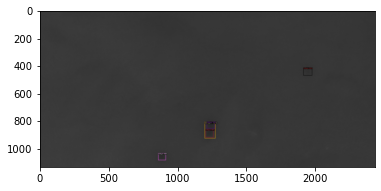

In [51]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
predictor = DefaultPredictor(cfg)
im = cv2.imread('Test Data for Particle Detection IFPAC/M100_3_06_06.png')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1], metadata=my_dataset_train_metadata,instance_mode=ColorMode.SEGMENTATION)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

cv2.imwrite('test.png', out.get_image()[:, :, ::-1])
cv2_imshow(out.get_image()[:, :, ::-1])

In [18]:
my_dataset_train_metadata

namespace(name='my_dataset_train',
          json_file='Training Data for Particle Detection IFPAC (1).json',
          image_root='Training Data for Particle Detection IFPAC',
          evaluator_type='coco',
          thing_classes=['100µm', 'fibers', '50µm'],
          thing_dataset_id_to_contiguous_id={1: 0, 3: 1, 16: 2})

### Prediction on entire folder without saving

/opt/Anaconda3/envs/QH/lib/python3.8/site-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/opt/Anaconda3/envs/QH/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1639180588308/work/aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/tmp/ipykernel_20227/1041143195.py:3: RuntimeWarning: More than 20 figures have been opened. Figures creat

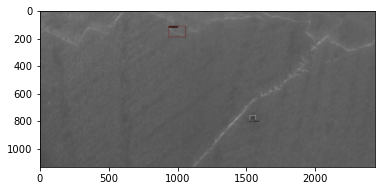

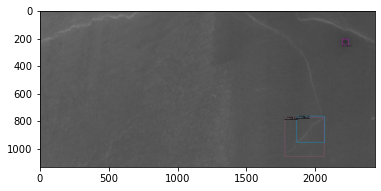

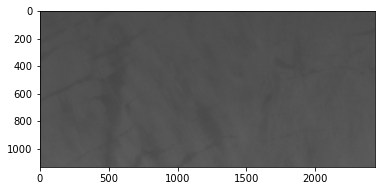

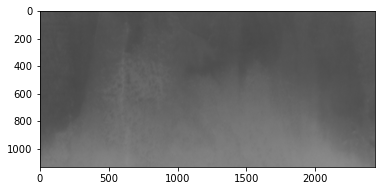

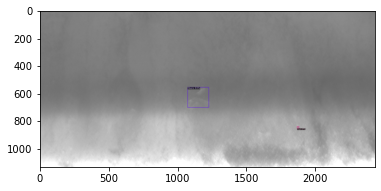

...

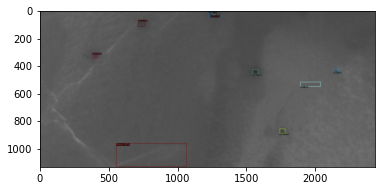

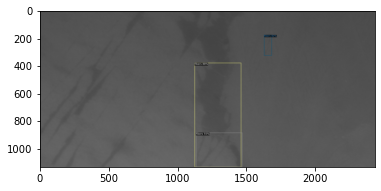

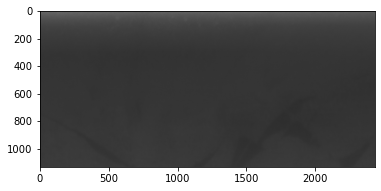

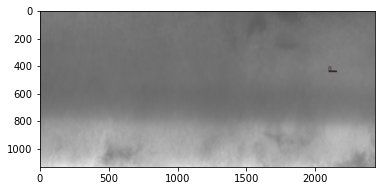

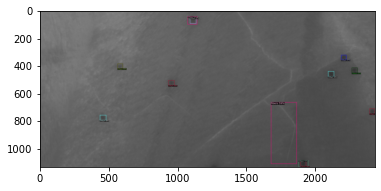

In [10]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.50 # set the testing threshold for this model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
predictor = DefaultPredictor(cfg)

for imageName in glob.glob('Test PJ Images/*png'):
    im = cv2.imread(imageName)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1], metadata=my_dataset_train_metadata,instance_mode=ColorMode.SEGMENTATION)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2.imwrite('test.png', out.get_image()[:, :, ::-1])
    cv2_imshow(out.get_image()[:, :, ::-1])

### Prediction on folder with saving in a new folder

/tmp/ipykernel_23485/1041143195.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(), plt.imshow(im), plt.axis('on')


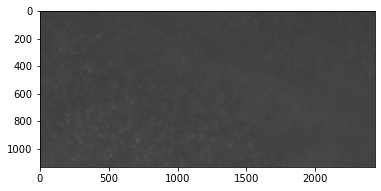

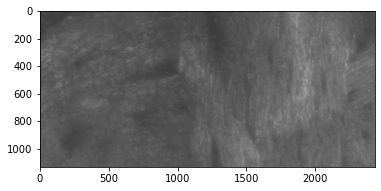

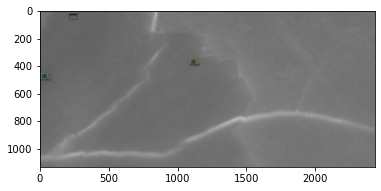

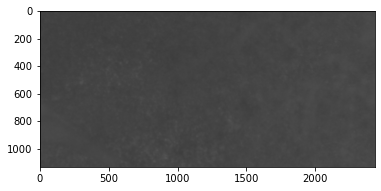

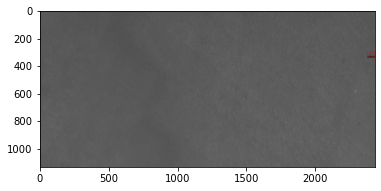

...

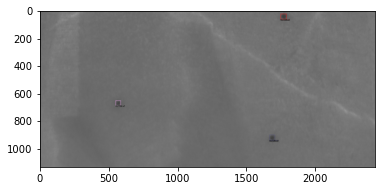

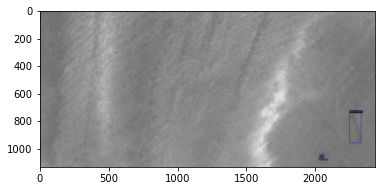

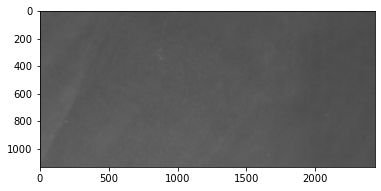

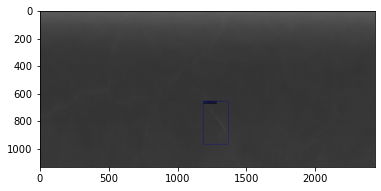

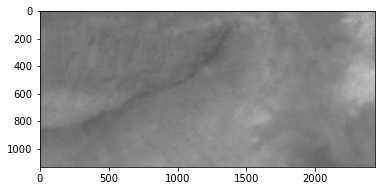

In [18]:
import os
import glob
import cv2

# Set the path to the input images directory
input_dir = 'Particle test folder'

# Set the path to the output images directory
output_dir = 'Lyoproject/Test folder2/'

# Set the model configuration
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.50 # set the testing threshold for this model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
predictor = DefaultPredictor(cfg)

# Loop over the input images and process each one
for imageName in glob.glob(os.path.join(input_dir, '*png')):
    # Load the input image
    im = cv2.imread(imageName)
    # Run the model inference
    outputs = predictor(im)
    # Visualize the output predictions
    v = Visualizer(im[:, :, ::-1], metadata=my_dataset_train_metadata,instance_mode=ColorMode.SEGMENTATION)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # Extract the file name (without extension) from the input image path
    filename = os.path.splitext(os.path.basename(imageName))[0]
    # Save the output image with a unique name based on the original file name
    cv2.imwrite(os.path.join(output_dir, f'{filename}_out.png'), out.get_image()[:, :, ::-1])
    # Display the output image
    cv2_imshow(out.get_image()[:, :, ::-1])

### Recompile images

In [16]:
# Recompile images

# Not working

import os
import numpy as np
import cv2

# Set the path to the directory containing the sliced images
path = 'Test folder'

# Set the dimensions of the original image
rows, cols = (11300, 24300)

# Initialize an empty numpy array to store the recompiled image
full_image = np.zeros((rows, cols), dtype=np.uint8)

# Loop over the sliced images and reassemble them
for filename in sorted(os.listdir(path)):
    if filename.endswith('out.png'):
        # Load the sliced image
        slice_image = cv2.imread(os.path.join(path, filename), cv2.IMREAD_GRAYSCALE)
        # Extract the row and column indices from the filename
        idx = [int(i) for i in filename.split('_')[1:3]]
        # Insert the slice into the full image array
        full_image[idx[0]:idx[0]+slice_image.shape[0], idx[1]:idx[1]+slice_image.shape[1]] += slice_image

# Save the recompiled image
cv2.imwrite('full_image.bmp', full_image)

True

In [20]:
# Not working name problem ?

import os
from PIL import Image

# set the dimensions of the final image
final_width = 24300
final_height = 11300

# set the directory where the images are located
image_dir = 'Test folder'

# get a list of all image files in the directory
image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg') or f.endswith('.png')]

# calculate the number of rows and columns needed to fit all the images in the final image
num_images = len(image_files)
num_columns = int(num_images**0.5)
num_rows = int(num_images**0.5)

# create a new blank image to hold the final image
final_image = Image.new('L', (final_width, final_height))  # set mode to 'L' for grayscale

# loop through each image and paste it onto the final image
for i, image_file in enumerate(image_files):
    # load the image
    img = Image.open(os.path.join(image_dir, image_file))
    # convert the image to grayscale
    img = img.convert('L')
    # resize the image to fit within the final image dimensions while maintaining its aspect ratio
    img.thumbnail((final_width//num_columns, final_height//num_rows))
    # calculate the coordinates where the image should be pasted onto the final image
    x = (i % num_columns) * (final_width // num_columns)
    y = (i // num_columns) * (final_height // num_rows)
    # paste the image onto the final image
    final_image.paste(img, (x, y))

# save the final image
final_image.save('final_image1.png')

In [ ]:
import cv2
import numpy as np
import os

# Define the folder containing the image slices
folder_path = 'Lyoproject/Test folder2/M50_3'

# Load all images in the folder
slices = []
for filename in os.listdir(folder_path):
    if filename.endswith(".png"):
        slice_image = cv2.imread(os.path.join(folder_path, filename))
        slices.append(slice_image)

# Determine the dimensions of the final image
height, width, channels = slices[0].shape
num_slices = len(slices)

# Create a new image with the desired dimensions
final_image = np.zeros((height, width*num_slices, channels), dtype=np.uint8)

# Insert each slice into the corresponding location in the final image
for i in range(num_slices):
    final_image[:, i*width:(i+1)*width, :] = slices[i]

# Display or save the final image
cv2.imshow("Final Image", final_image)
cv2.waitKey(0)
cv2.imwrite("final_image.png", final_image)
